# Data augmentation

## Display functions and libs

In [1]:
from numpy import reshape
import seaborn as sns
import pandas as pd  
import torch
from os import listdir, walk
from os.path import isfile, join
from tqdm import tqdm
import matplotlib.pyplot as plt
import librosa.display
import IPython.display as ipd
import soundfile as sf
import numpy as np
from IPython.display import display, Audio
import librosa
import random
def ms2samples(time, rate):
    return int((time/1000)*rate)

def samples2ms(sample,rate):
    return int((sample/rate)*1000)
    
def graph_n_play(y,sr):
    plt.figure(figsize=(14, 5))
    librosa.display.waveplot(y, sr=sr)
    plt.show()
    ipd.display(ipd.Audio(y,rate = sr))
def linear_n_play(audio_path):
    # y, sr = sf.read(audio_path)
    y, sr = librosa.load(audio_path, sr=None)
    fig, ax = plt.subplots()
    D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    img = librosa.display.specshow(D, y_axis='linear', x_axis='time',
                                   sr=sr, ax=ax)
    ax.set(title='Linear-frequency power spectrogram')
    ax.label_outer()
    display(Audio(y,rate=sr))
    plt.show()
def recursive_list_files(path):
    """Recursively lists all files in a directory and its subdirectories"""
    files = []
    for dirpath, dirnames, filenames in walk(path):
        for filename in filenames:
            files.append(join(dirpath, filename))
    return files

## check musan noise data

Sample rate: 16000
Channels: 1
Duration: 206.367


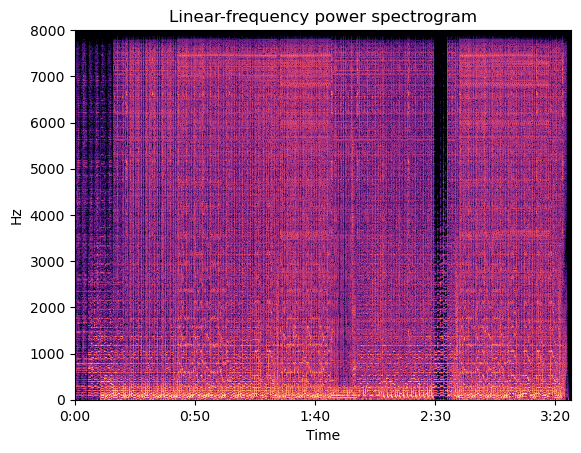

In [3]:
dir_path = '/dataa/Dataset/Noise/musan/music/jamendo/'
noise_path = [f for f in listdir(dir_path) if (isfile(join(dir_path, f)) and (f.endswith('.wav')))]
# print(noise_path)
sample = random.choice(noise_path)
with sf.SoundFile(join(dir_path,sample)) as f:
    # print the sound file's metadata
    print('Sample rate: {}'.format(f.samplerate))
    print('Channels: {}'.format(f.channels))
    print('Duration: {}'.format(len(f) / f.samplerate))
linear_n_play(join(dir_path,sample))

## check RIR noise

In [4]:
dir_path = '/dataa/Dataset/Noise/RIRS_NOISES/simulated_rirs/'
noise_path = [f for f in recursive_list_files(dir_path) if ((isfile(f)) and (f.endswith('.wav')))]

Sample name: /dataa/Dataset/Noise/RIRS_NOISES/simulated_rirs/smallroom/Room160/Room160-00100.wav
Sample rate: 16000
Channels: 1
Duration: 0.5


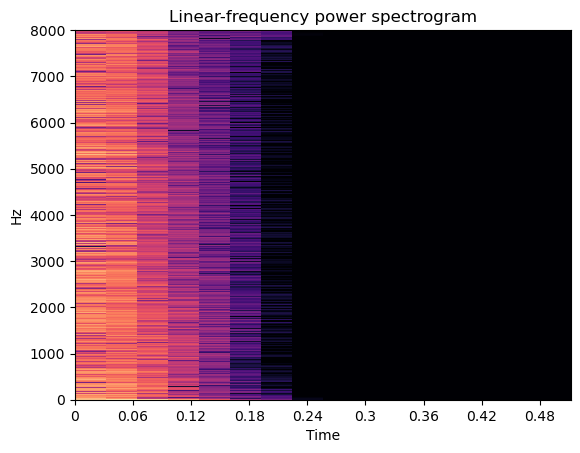

In [41]:

# print(noise_path)
sample = random.choice(noise_path)
with sf.SoundFile(join(dir_path,sample)) as f:
    # print the sound file's metadata
    print('Sample name: {}'.format(sample))
    print('Sample rate: {}'.format(f.samplerate))
    print('Channels: {}'.format(f.channels))
    print('Duration: {}'.format(len(f) / f.samplerate))
linear_n_play(join(dir_path,sample))

# Make reverberated audio

## With numpy and scipy

In [52]:
import scipy.signal as ss
import soundfile as sf
# Load RIR sample and original audio
original, orig_sr = sf.read("./test/LA_T_1000137.flac")
rir, rir_sr = sf.read(sample)

# Make sure that the sampling rate of the two signals match
if orig_sr != rir_sr:
    raise ValueError("Mismatched sampling rate between RIR and audio")

# Compute convolution
reverberate = np.convolve(original, rir)

# Normalize output signal to avoid clipping
reverberate /= np.max(np.abs(reverberate))

print(original.shape)
print(reverberate.shape)

# Save the output signal
sf.write('test/reverberated_audio.wav', reverberate, orig_sr, subtype='PCM_16')

(40006,)
(48005,)


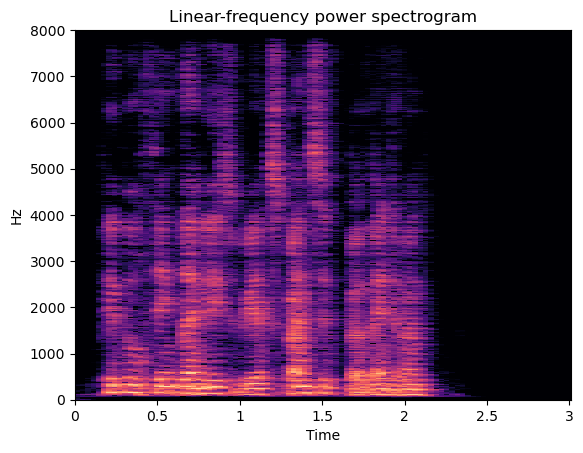

Sample rate: 16000
Channels: 1
Duration: 3.0003125


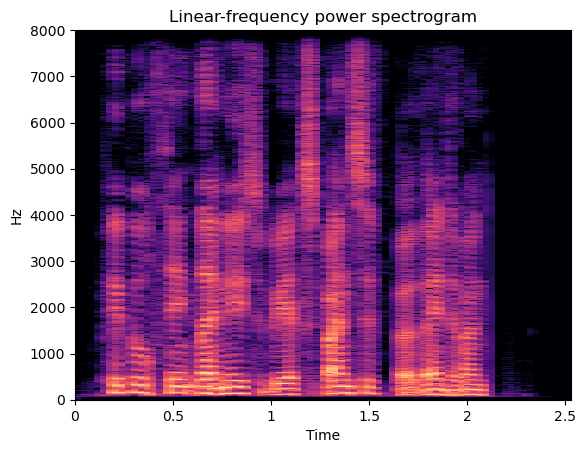

In [43]:
linear_n_play('test/reverberated_audio.wav')
with sf.SoundFile('test/reverberated_audio.wav') as f:
    # print the sound file's metadata
    print('Sample rate: {}'.format(f.samplerate))
    print('Channels: {}'.format(f.channels))
    print('Duration: {}'.format(len(f) / f.samplerate))
linear_n_play('./test/LA_T_1000137.flac')

## With torchaudio

In [16]:
import torch
import torchaudio
import torchaudio.functional as F

print(torch.__version__)
print(torchaudio.__version__)

def plot_waveform(waveform, sample_rate, title="Waveform", xlim=None):
    waveform = waveform.numpy()

    num_channels, num_frames = waveform.shape
    time_axis = torch.arange(0, num_frames) / sample_rate

    figure, axes = plt.subplots(num_channels, 1)
    if num_channels == 1:
        axes = [axes]
    for c in range(num_channels):
        axes[c].plot(time_axis, waveform[c], linewidth=1)
        axes[c].grid(True)
        if num_channels > 1:
            axes[c].set_ylabel(f"Channel {c+1}")
        if xlim:
            axes[c].set_xlim(xlim)
    figure.suptitle(title)
    plt.show(block=False)

def plot_specgram(waveform, sample_rate, title="Spectrogram", xlim=None):
    waveform = waveform.numpy()

    num_channels, _ = waveform.shape

    figure, axes = plt.subplots(num_channels, 1)
    if num_channels == 1:
        axes = [axes]
    for c in range(num_channels):
        axes[c].specgram(waveform[c], Fs=sample_rate)
        if num_channels > 1:
            axes[c].set_ylabel(f"Channel {c+1}")
        if xlim:
            axes[c].set_xlim(xlim)
    figure.suptitle(title)
    plt.show(block=False)

1.12.1
0.12.1


In [44]:
SAMPLE_WAV = 'test/LA_T_1000137.flac'
SAMPLE_RIR = sample

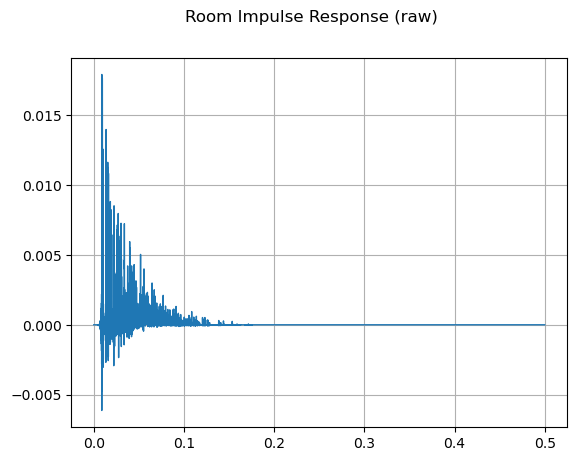

/home/phucdt/anaconda3/envs/py39/lib/python3.9/site-packages/matplotlib/axes/_axes.py:7773: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


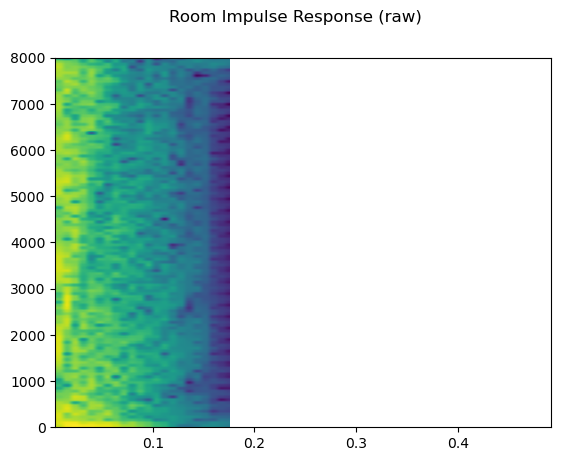

In [45]:
rir_raw, sample_rate = torchaudio.load(SAMPLE_RIR)
plot_waveform(rir_raw, sample_rate, title="Room Impulse Response (raw)")
plot_specgram(rir_raw, sample_rate, title="Room Impulse Response (raw)")
Audio(rir_raw, rate=sample_rate)

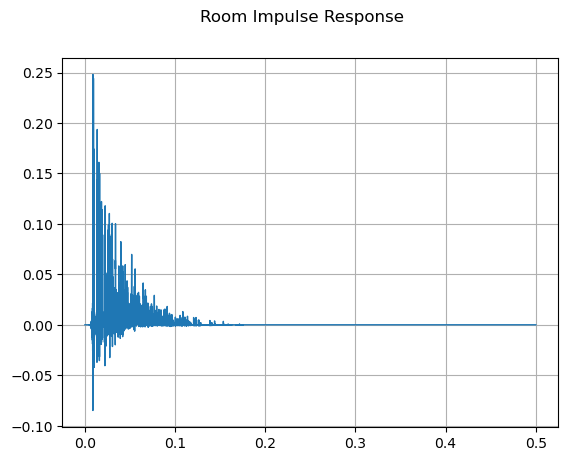

In [46]:
# First, we need to clean up the RIR. We extract the main impulse, normalize the signal power, then flip along the time axis.
rir = rir_raw
rir = rir / torch.norm(rir, p=2)
RIR = torch.flip(rir, [1])

plot_waveform(rir, sample_rate, title="Room Impulse Response")

In [47]:
# Then, we convolve the speech signal with the RIR filter.
speech, _ = torchaudio.load(SAMPLE_WAV)

speech_ = torch.nn.functional.pad(speech, (RIR.shape[1] - 1, 0))
augmented = torch.nn.functional.conv1d(speech_[None, ...], RIR[None, ...])[0]

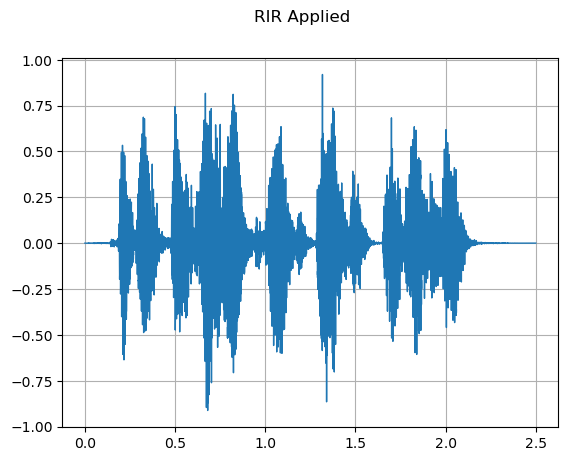

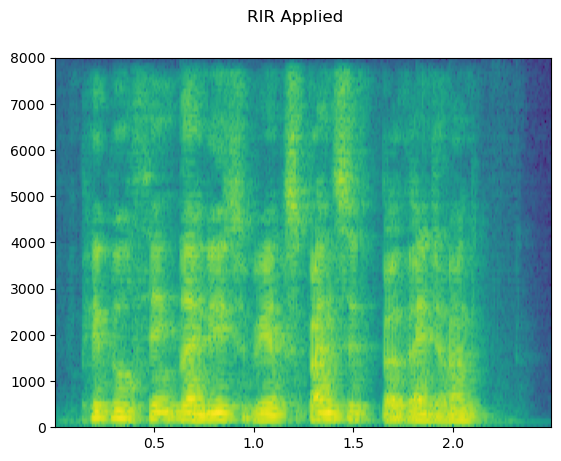

In [48]:
plot_waveform(augmented, sample_rate, title="RIR Applied")
plot_specgram(augmented, sample_rate, title="RIR Applied")
Audio(augmented, rate=sample_rate)

Sample rate: 16000
Channels: 1
Duration: 2.500375


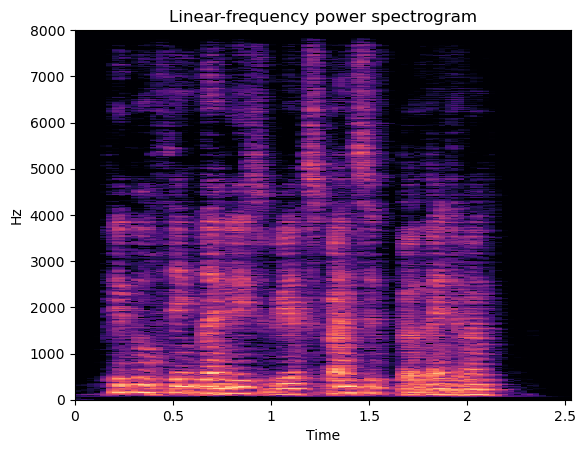

In [51]:
torchaudio.save(
    'test/reverberated_audio.wav', augmented, sample_rate,
    encoding="PCM_S", bits_per_sample=16)
with sf.SoundFile('test/reverberated_audio.wav') as f:
    # print the sound file's metadata
    print('Sample rate: {}'.format(f.samplerate))
    print('Channels: {}'.format(f.channels))
    print('Duration: {}'.format(len(f) / f.samplerate))
linear_n_play('test/reverberated_audio.wav')

# Add real-world noise

In [2]:
SAMPLE_WAV = "test/LA_T_1000137.flac"

## with self libs

In [3]:
CONFIG = {
    "aug_type": "background_noise",
    "output_path": "test/augmented",
    "out_format": "flac",
    "noise_path": "./musan",
    "min_SNR_dB": 0,
    "max_SNR_dB": 20
}

In [7]:
from audio_augmentor import BackgroundNoiseAugmentor

bga = BackgroundNoiseAugmentor(SAMPLE_WAV, CONFIG)
bga.run()


## Using pydub

In [127]:
from pydub import AudioSegment
import random

def add_noise(audio_file_path, noise_file_path, min_SNR_dB=0, max_SNR_dB=20):
    # Load audio files
    audio_file = AudioSegment.from_file(audio_file_path)
    noise_file = AudioSegment.from_file(noise_file_path)


    # Set the desired SNR (signal-to-noise ratio) level in decibels
    SNR_dB = random.randint(min_SNR_dB, max_SNR_dB)

    # Calculate the power of the signal and noise
    signal_power = audio_file.dBFS
    noise_power = noise_file.dBFS

    # Calculate the scaling factor for the noise
    scaling_factor = SNR_dB * noise_power / signal_power
    
    # Add noise to the original audio file
    scaled_audio = audio_file.apply_gain(scaling_factor)
    augmented_audio = scaled_audio.overlay(noise_file)
    return augmented_audio

def add_noise_torch(audio_file_path, noise_file_path, min_SNR_dB=0, max_SNR_dB=20):
    # Load audio files
    audio_file, _ = torchaudio.load(audio_file_path)
    noise_file, _ = torchaudio.load(noise_file_path)
    
    # padding
    noise_file = noise_file[:, : audio_file.shape[1]]
    
    # Set the desired SNR (signal-to-noise ratio) level in decibels
    SNR_dB = random.randint(min_SNR_dB, max_SNR_dB)

    # Calculate the power of the signal and noise
    signal_power = audio_file.norm(p=2)
    noise_power = noise_file.norm(p=2)

    # Calculate the scaling factor for the noise
    snr = 10 ** (SNR_dB / 20)
    scaling_factor = snr * noise_power / signal_power

    # Add noise to the original audio file
    augmented_audio = scaling_factor * audio_file + noise_file
    return augmented_audio

def select_noise(noise_path):
    noise_list = recursive_list_files(noise_path)
    noise_file = random.choice(noise_list)
    return noise_file


In [129]:
SAMPLE_WAV = 'test/LA_T_1000137.flac'
SAMPLE_NOISE = select_noise('musan')

Original


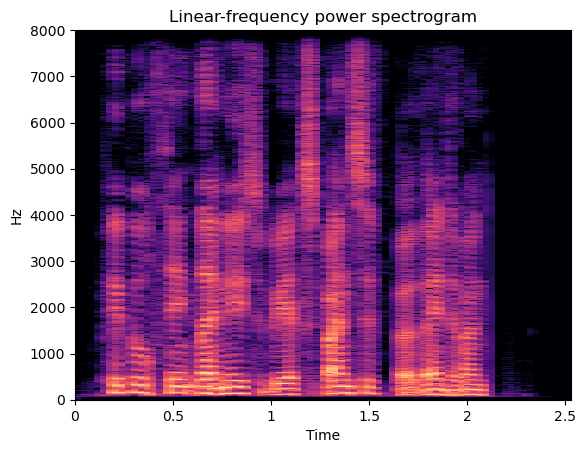

Sample rate: 16000
Channels: 1
Duration: 2.500375
Noisy


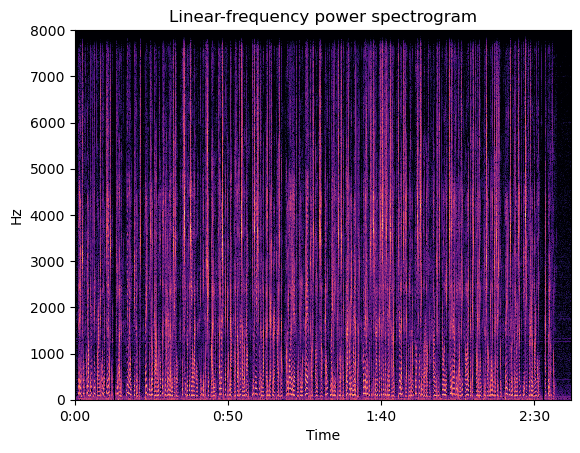

Sample rate: 16000
Channels: 1
Duration: 161.8808125
Augmented


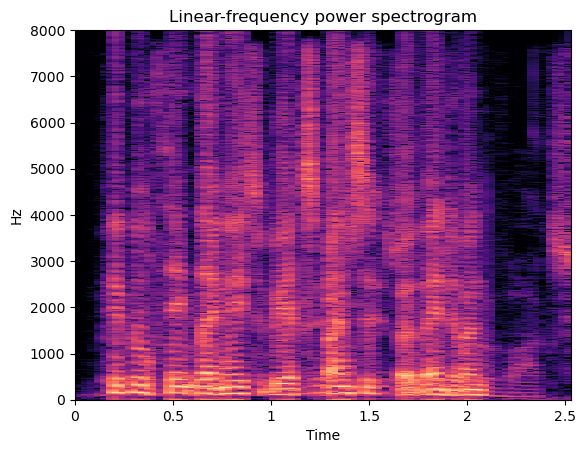

Sample rate: 16000
Channels: 1
Duration: 2.5


In [130]:
augmented_audio = add_noise(SAMPLE_WAV, SAMPLE_NOISE)
augmented_audio.export('test/noisy_audio.wav', format='wav')

print('Original')
linear_n_play(SAMPLE_WAV)
with sf.SoundFile(SAMPLE_WAV) as f:
    # print the sound file's metadata
    print('Sample rate: {}'.format(f.samplerate))
    print('Channels: {}'.format(f.channels))
    print('Duration: {}'.format(len(f) / f.samplerate))

print('Noisy')
linear_n_play(SAMPLE_NOISE)
with sf.SoundFile(SAMPLE_NOISE) as f:
    # print the sound file's metadata
    print('Sample rate: {}'.format(f.samplerate))
    print('Channels: {}'.format(f.channels))
    print('Duration: {}'.format(len(f) / f.samplerate))

print('Augmented')
linear_n_play('test/noisy_audio.wav')
with sf.SoundFile('test/noisy_audio.wav') as f:
    # print the sound file's metadata
    print('Sample rate: {}'.format(f.samplerate))
    print('Channels: {}'.format(f.channels))
    print('Duration: {}'.format(len(f) / f.samplerate))


Original


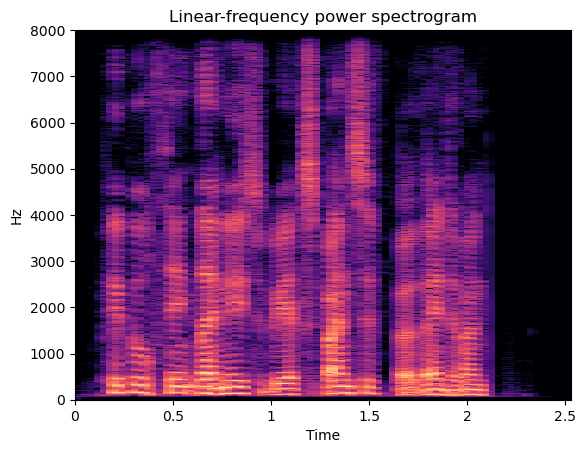

Sample rate: 16000
Channels: 1
Duration: 2.500375
Noisy


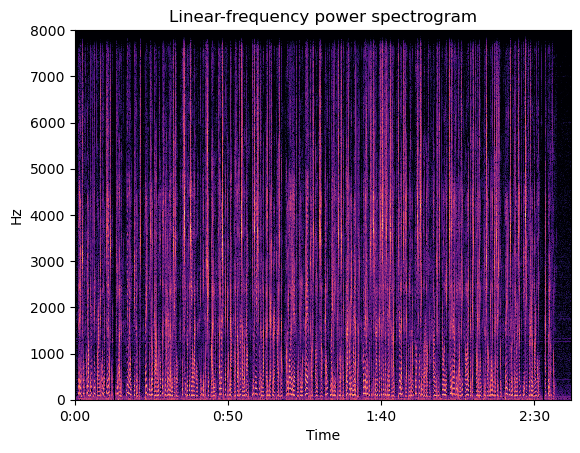

Sample rate: 16000
Channels: 1
Duration: 161.8808125
Augmented


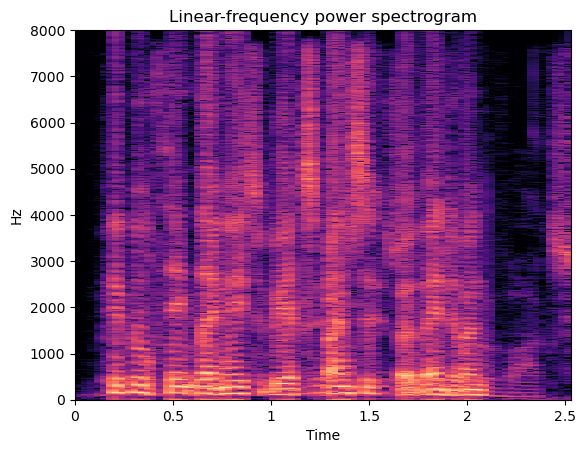

Sample rate: 16000
Channels: 1
Duration: 2.5


In [131]:
augmented_audio = add_noise_torch(SAMPLE_WAV, SAMPLE_NOISE)
torchaudio.save(
    'test/noisy_audio_torch.wav', augmented_audio, 16000,
    encoding="PCM_S", bits_per_sample=16)

print('Original')
linear_n_play(SAMPLE_WAV)
with sf.SoundFile(SAMPLE_WAV) as f:
    # print the sound file's metadata
    print('Sample rate: {}'.format(f.samplerate))
    print('Channels: {}'.format(f.channels))
    print('Duration: {}'.format(len(f) / f.samplerate))

print('Noisy')
linear_n_play(SAMPLE_NOISE)
with sf.SoundFile(SAMPLE_NOISE) as f:
    # print the sound file's metadata
    print('Sample rate: {}'.format(f.samplerate))
    print('Channels: {}'.format(f.channels))
    print('Duration: {}'.format(len(f) / f.samplerate))

print('Augmented')
linear_n_play('test/noisy_audio.wav')
with sf.SoundFile('test/noisy_audio.wav') as f:
    # print the sound file's metadata
    print('Sample rate: {}'.format(f.samplerate))
    print('Channels: {}'.format(f.channels))
    print('Duration: {}'.format(len(f) / f.samplerate))


# Speed perturbation

In [3]:
SAMPLE_WAV = "test/LA_T_1000137.flac"

Original audio


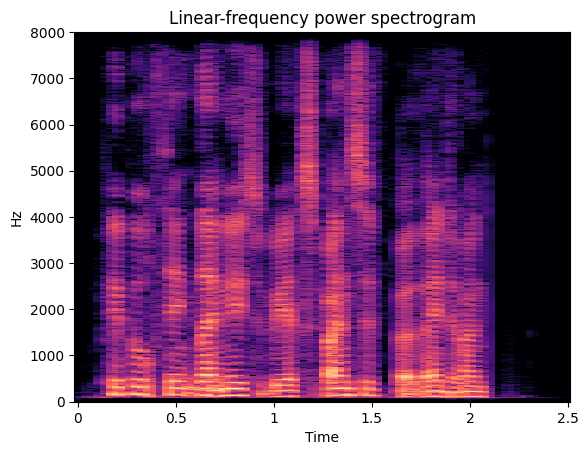

In [10]:
print("Original audio")
linear_n_play(SAMPLE_WAV)

## Using librosa

In [5]:
import librosa
import soundfile as sf

# load audio file
audio, sr = sf.read(SAMPLE_WAV)

# set speed ratio (e.g. 1.5 for speeding up by 50%)
speed_ratio = 1.1

# time stretch audio
stretched_audio = librosa.effects.time_stretch(audio, rate=speed_ratio)

# save output audio
sf.write('test/speed_audio.wav', stretched_audio, sr, subtype='PCM_16')

slow down audio 1.1


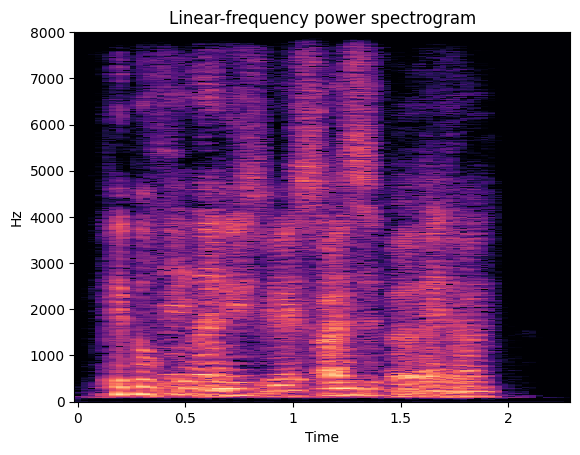

In [6]:
print("slow down audio 1.1")
linear_n_play('test/speed_audio.wav')

## Using torchaudio

In [26]:
import torch
import torchaudio

# load audio file
audio, sr = torchaudio.load(SAMPLE_WAV)

# set ratio
sox_effects = [
            ["speed", str(1.1)],
            ["rate", str(sr)],
        ]

transformed_audio, _ = torchaudio.sox_effects.apply_effects_tensor(audio, sr, sox_effects)
# save output audio
torchaudio.save('test/speed_audio.wav', transformed_audio, sr)

Speed up audio 1.1


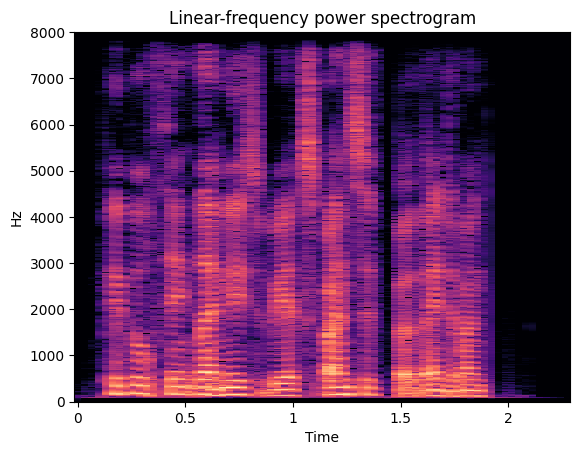

In [27]:
print("Speed up audio 1.1")
linear_n_play('test/speed_audio.wav')

## Using pydub

In [13]:
from pydub import AudioSegment
from pydub import effects

speed_ratio = 1.5 

sound = AudioSegment.from_file(SAMPLE_WAV)
so = sound.speedup(speed_ratio, 150, 25)
so.export('test/speed_audio.wav', format='wav')

<_io.BufferedRandom name='test/speed_audio.wav'>

SLow  audio 15


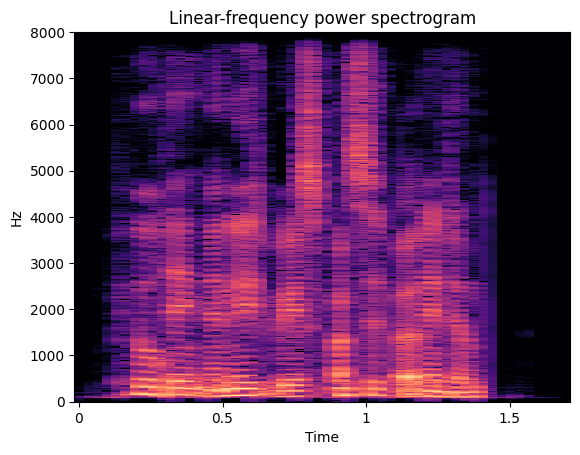

In [14]:
print("Speed up audio 1.5")
linear_n_play('test/speed_audio.wav')

# pitch modulation

In [21]:
import random
SAMPLE_WAV="test/LA_T_1000137.flac"
pitch = random.randint(-5,5)

## Using librosa

In [15]:
import numpy as np
import librosa
import soundfile as sf


In [16]:

y, sr = librosa.load(SAMPLE_WAV)
y = librosa.effects.pitch_shift(y, sr=sr, n_steps=pitch)
sf.write('test/pitch_audio.wav', y, sr, subtype='PCM_16')

Original


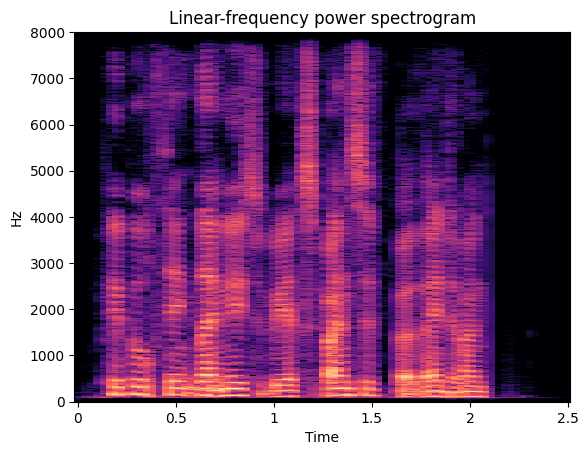

pitch change


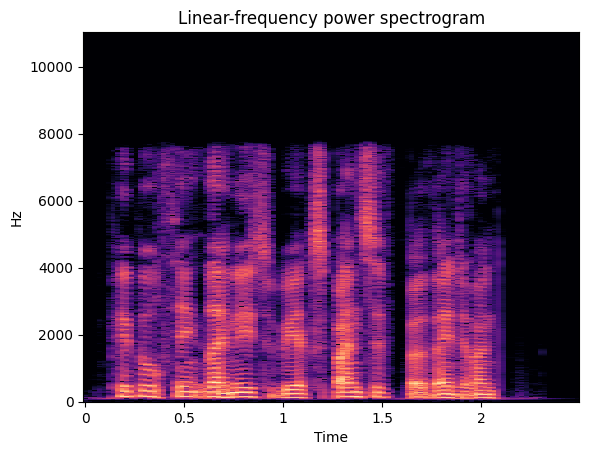

In [17]:
print("Original")
linear_n_play(SAMPLE_WAV)
print("pitch change")
linear_n_play("test/pitch_audio.wav")

## Using torchaudio

In [22]:
import torch
import torchaudio

# load audio file
audio, sr = torchaudio.load(SAMPLE_WAV)

transformed_audio = torchaudio.functional.pitch_shift(audio, sr, pitch)
# save output audio
torchaudio.save('test/pitch_audio.wav', transformed_audio, sr)

Original


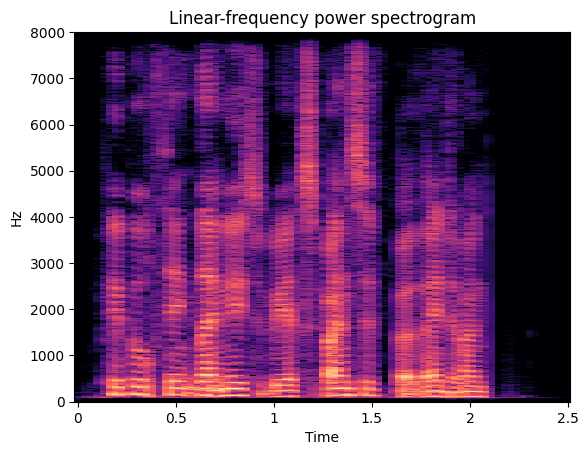

pitch change -3


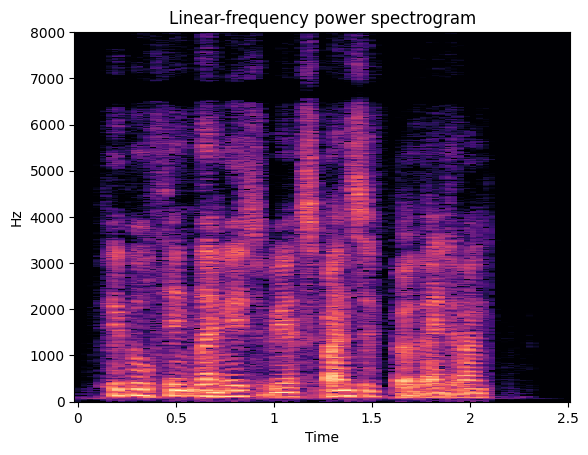

In [24]:
print("Original")
linear_n_play(SAMPLE_WAV)
print("pitch change {}".format(pitch))
linear_n_play("test/pitch_audio.wav")

# Codec


In [37]:
SAMPLE_WAV="test/LA_T_1000137.flac"

## Using torchaudio

In [60]:
import torch
import torchaudio

# load audio file
audio, sr = torchaudio.load(SAMPLE_WAV)

# Set audio backend
torchaudio.set_audio_backend("sox_io")

# config
config={"format": "ogg", "compression": 7}

#save
torchaudio.save('test/converted_audio.ogg', augmented, sr, **config)


## Using pydub

In [61]:
from pydub import AudioSegment

sound = AudioSegment.from_file(SAMPLE_WAV, format="flac")

In [80]:
sound.export("test/converted_audio.ogg", format="ogg", bitrate="128k")

CouldntEncodeError: Encoding failed. ffmpeg/avlib returned error code: 1

Command:['ffmpeg', '-y', '-f', 'wav', '-i', '/tmp/tmpf2u616gs', '-acodec', 'libvorbis', '-b:a', '128k', '-f', 'ogg', '/tmp/tmp32pg5nuz']

Output from ffmpeg/avlib:

ffmpeg version 4.3 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/opt/conda/conda-bld/ffmpeg_1597178665428/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeh --cc=/opt/conda/conda-bld/ffmpeg_1597178665428/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --disable-openssl --enable-avresample --enable-gnutls --enable-hardcoded-tables --enable-libfreetype --enable-libopenh264 --enable-pic --enable-pthreads --enable-shared --disable-static --enable-version3 --enable-zlib --enable-libmp3lame
  libavutil      56. 51.100 / 56. 51.100
  libavcodec     58. 91.100 / 58. 91.100
  libavformat    58. 45.100 / 58. 45.100
  libavdevice    58. 10.100 / 58. 10.100
  libavfilter     7. 85.100 /  7. 85.100
  libavresample   4.  0.  0 /  4.  0.  0
  libswscale      5.  7.100 /  5.  7.100
  libswresample   3.  7.100 /  3.  7.100
Guessed Channel Layout for Input Stream #0.0 : mono
Input #0, wav, from '/tmp/tmpf2u616gs':
  Duration: 00:00:02.50, bitrate: 256 kb/s
    Stream #0:0: Audio: pcm_s16le ([1][0][0][0] / 0x0001), 16000 Hz, mono, s16, 256 kb/s
Unknown encoder 'libvorbis'


/tmp/ipykernel_1218938/4150610576.py:29: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(audio_path, sr=None)
/home/phucdt/anaconda3/envs/torch201/lib/python3.9/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


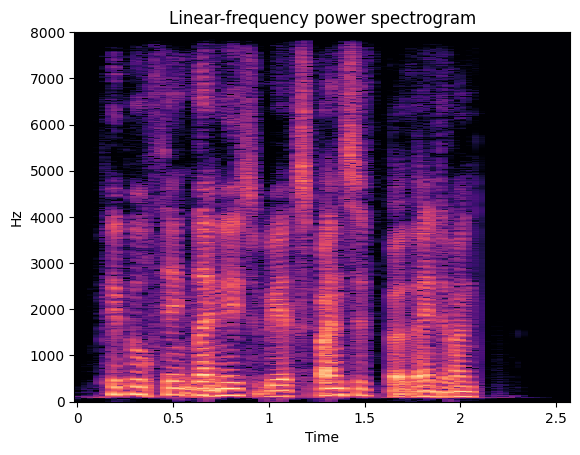

In [81]:
linear_n_play("test/converted_audio.m4a")

# Volume Augmentation

In [6]:
SAMPLE_WAV = 'test/LA_T_1000137.flac'
VOLUME = random.randint(-4,4)

In [7]:
from pydub import AudioSegment
from pydub.playback import play
# Load audio
original_audio = AudioSegment.from_file(SAMPLE_WAV)
# Change volume
augmented_audio = original_audio + VOLUME
# save to file
augmented_audio.export('test/volume_audio.wav', format='wav')

<_io.BufferedRandom name='test/volume_audio.wav'>

Original


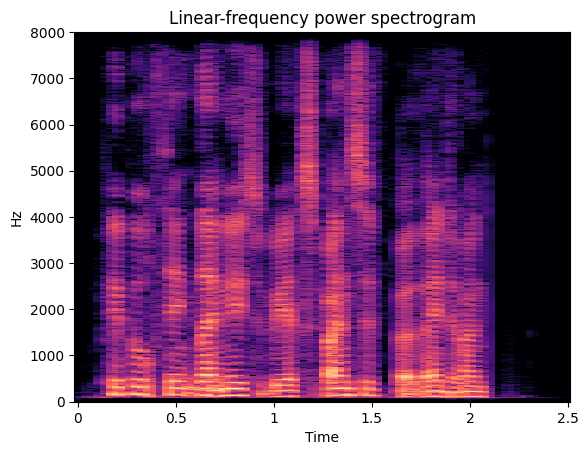

Volume 3


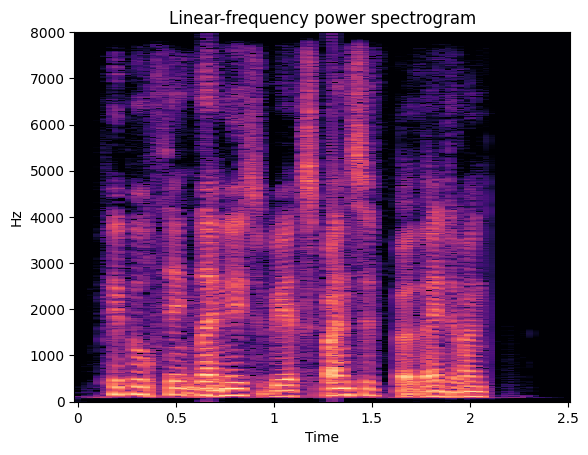

In [8]:
print("Original")
linear_n_play(SAMPLE_WAV)
print("Volume {}".format(VOLUME))
linear_n_play("test/volume_audio.wav")